In [171]:
%cd ai4r-gym

[Errno 2] No such file or directory: 'ai4r-gym'
/Users/ybguzel/Desktop/Full-Scale-Autonomous-Driving/PPO_RL/ai4r-gym


/Users/ybguzel/Desktop/Full-Scale-Autonomous-Driving/PPO_RL/myenv/lib/python3.10/site-packages/IPython/core/magics/osm.py:393: UserWarning: This is now an optional IPython functionality, using bookmarks requires you to install the `pickleshare` library.
  bkms = self.shell.db.get('bookmarks', {})


## Imports

In [172]:
import ai4rgym
from ai4rgym.envs.road import Road
import gymnasium as gym
import numpy as np
import random
from stable_baselines3 import PPO, SAC, DDPG
from utils import ensure_dir, ensure_dirs, eval_model
import matplotlib.pyplot as plt
from stable_baselines3.common.vec_env import SubprocVecEnv
from stable_baselines3.common.env_util import make_vec_env

## Environment Settings:

In [173]:
# SPECIFY THE VEHCILE PARAMETERS
bicycle_model_parameters = {
    "Lf" : 0.55*2.875,
    "Lr" : 0.45*2.875,
    "m"  : 2000.0,
    "Iz" : (1.0/12.0) * 2000.0 * (4.692**2+1.850**2),
    "Cm" : (1.0/100.0) * (1.0 * 400.0 * 9.0) / 0.2286,
    "Cd" : 0.5 * 0.24 * 2.2204 * 1.202,
    "delta_offset" : 0 * np.pi/180,
    "delta_request_max" : 45 * np.pi/180,
    "Ddelta_lower_limit" : -45 * np.pi/180,
    "Ddelta_upper_limit" :  45 * np.pi/180,
    "v_transition_min": 3.0,    # v_transition_min = 3.0 m/s
    "v_transition_max": 5.0,    # v_transition_max = 5.0 m/s
    "body_len_f" : (0.55*2.875) * 1.5,
    "body_len_r" : (0.45*2.875) * 1.5,
    "body_width" : 2.50,
}

# SPECIFY THE ROAD

# This road will not be used for training / evaluation
# this is just kept in place to initialize the environment
road_elements_list = [
    {"type":"straight", "length":100.0},
    {"type":"curved", "curvature":1/800.0, "angle_in_degrees":15.0},
    {"type":"straight", "length":100.0},
    {"type":"curved", "curvature":-1/400.0, "angle_in_degrees":30.0},
    {"type":"straight", "length":100.0},
]

# SPECIFY THE NUMERICAL INTEGRATION DETAILS
numerical_integration_parameters = {
    "method" : "rk4",
    "Ts" : 0.05,
    "num_steps_per_Ts" : 1,
}

# SPECIFY THE INITIAL STATE DISTRIBUTION
py_init_min = -1.0
py_init_max =  1.0

v_init_min_in_kmh = 50.0
v_init_max_in_kmh = 60.0

initial_state_bounds = {
    "px_init_min" : 0.0,
    "px_init_max" : 0.0,
    "py_init_min" : py_init_min,
    "py_init_max" : py_init_max,
    "theta_init_min" : 0.0,
    "theta_init_max" : 0.0,
    "vx_init_min" : v_init_min_in_kmh * (1.0/3.6),
    "vx_init_max" : v_init_max_in_kmh * (1.0/3.6),
    "vy_init_min" : 0.0,
    "vy_init_max" : 0.0,
    "omega_init_min" : 0.0,
    "omega_init_max" : 0.0,
    "delta_init_min" : 0.0,
    "delta_init_max" : 0.0,
}

# SPECIFY THE TERMINATION PARAMETERS
termination_parameters = {
    "speed_lower_bound"  :  0.0,
    "speed_upper_bound"  :  (200.0/3.6),
    "distance_to_closest_point_upper_bound"  :  25.0,
    "reward_speed_lower_bound"  :  0.0,
    "reward_speed_upper_bound"  :  0.0,
    "reward_distance_to_closest_point_upper_bound"  :  0.0,
}



## Setting Observations: 

In [174]:
# SPECIFY THE OBSERVATION PARAMETERS
observation_parameters = {
    "should_include_ground_truth_px"                       :  "info",
    "should_include_ground_truth_py"                       :  "info",
    "should_include_ground_truth_theta"                    :  "info",
    "should_include_ground_truth_vx"                       :  "info",
    "should_include_ground_truth_vy"                       :  "info",
    "should_include_ground_truth_omega"                    :  "info",
    "should_include_ground_truth_delta"                    :  "info",
    "should_include_road_progress_at_closest_point"        :  "info",
    "should_include_vx_sensor"                             :  "info",
    "should_include_distance_to_closest_point"             :  "obs",
    "should_include_heading_angle_relative_to_line"        :  "obs",
    "should_include_heading_angular_rate_gyro"             :  "info",
    "should_include_closest_point_coords_in_body_frame"    :  "info",
    "should_include_look_ahead_line_coords_in_body_frame"  :  "info",
    "should_include_road_curvature_at_closest_point"       :  "obs",
    "should_include_look_ahead_road_curvatures"            :  "info",

    "scaling_for_ground_truth_px"                       :  1.0,
    "scaling_for_ground_truth_py"                       :  1.0,
    "scaling_for_ground_truth_theta"                    :  1.0,
    "scaling_for_ground_truth_vx"                       :  1.0,
    "scaling_for_ground_truth_vy"                       :  1.0,
    "scaling_for_ground_truth_omega"                    :  1.0,
    "scaling_for_ground_truth_delta"                    :  1.0,
    "scaling_for_road_progress_at_closest_point"        :  1.0,
    "scaling_for_vx_sensor"                             :  1.0,
    "scaling_for_distance_to_closest_point"             :  1.0,
    "scaling_for_heading_angle_relative_to_line"        :  1.0,
    "scaling_for_heading_angular_rate_gyro"             :  1.0,
    "scaling_for_closest_point_coords_in_body_frame"    :  1.0,
    "scaling_for_look_ahead_line_coords_in_body_frame"  :  1.0,
    "scaling_for_road_curvature_at_closest_point"       :  1.0,
    "scaling_for_look_ahead_road_curvatures"            :  1.0,

    "vx_sensor_bias"    : 0.0,
    "vx_sensor_stddev"  : 0.1,

    "distance_to_closest_point_bias"    :  0.0,
    "distance_to_closest_point_stddev"  :  0.01,

    "heading_angle_relative_to_line_bias"    :  0.0,
    "heading_angle_relative_to_line_stddev"  :  0.01,

    "heading_angular_rate_gyro_bias"    :  0.0,
    "heading_angular_rate_gyro_stddev"  :  0.01,

    "closest_point_coords_in_body_frame_bias"    :  0.0,
    "closest_point_coords_in_body_frame_stddev"  :  0.0,

    "look_ahead_line_coords_in_body_frame_bias"    :  0.0,
    "look_ahead_line_coords_in_body_frame_stddev"  :  0.0,

    "road_curvature_at_closest_point_bias"    :  0.0,
    "road_curvature_at_closest_point_stddev"  :  0.0,

    "look_ahead_road_curvatures_bias"    :  0.0,
    "look_ahead_road_curvatures_stddev"  :  0.0,

    "look_ahead_line_coords_in_body_frame_distance"    :  100.0,
    "look_ahead_line_coords_in_body_frame_num_points"  :  10,
}

## Global Variables

In [175]:
# Specify the length of the simulation in time steps
N_sim = 50000
# Specify the seed for when the simulate function resets the random number generator
sim_seed = 1
# Specify the length of the RL training
TIMESTEPS_PER_EPOCH = 500000
N_EPOCHS = 7
speed_limit = 100.0 / 3.6
Ts_sim = 0.05
integration_method = "rk4"
road_condition="wet"
PPO_STEPS = 2048
A2C_STEPS = 1024
BATCH_SIZE = 128

## Reward Function


In [176]:
# Define the RewardWrapper as previously defined
import math
class RewardWrapper(gym.Wrapper):
    def __init__(self, env, progress_key='road_progress_at_closest_point', reward_value=10):
        """
        Custom Reward Wrapper that rewards the agent only when it surpasses its maximum progress.

        Parameters:
        - env (gym.Env): The environment to wrap.
        - progress_key (str): The key to extract progress from the info dictionary.
        - reward_value (float): The fixed reward to assign when conditions are met.
        """
        super(RewardWrapper, self).__init__(env)
        self.progress_key = progress_key
        self.reward_value = reward_value
        self.max_progress = 0  # Initialize the maximum progress

    def reset(self, **kwargs):
        """
        Resets the environment and initializes the maximum progress tracker.
        """
        self.max_progress = 0
        return self.env.reset(**kwargs)

    def step(self, action):
        """
        Executes the action, calculates the custom reward, and returns the modified outcome.

        Parameters:
        - action: The action to take in the environment.

        Returns:
        - observation: The next observation.
        - custom_reward: The calculated reward based on progress.
        - terminated: Whether the episode has terminated.
        - truncated: Whether the episode has been truncated.
        - info: Additional information from the environment.
        """
        observation, original_reward, terminated, truncated, info = self.env.step(action)


        current_progress = info.get(self.progress_key, 0)
        distance_to_center = observation['distance_to_closest_point'][0]
        vx_sensor = info['vx_sensor'][0]  
        angle_direction = observation["heading_angle_relative_to_line"][0]
        
        
        # Initialize custom reward
        custom_reward = 0.0

        # Check if current progress exceeds the maximum progress
        if current_progress >= self.max_progress:
            custom_reward =  50
            self.max_progress = current_progress  # Update the maximum progress
        else:
            custom_reward = 0
            
        custom_reward -= abs(distance_to_center)*2
        custom_reward += vx_sensor 
        # custom_reward -= abs(angle_direction)


        return observation, custom_reward, terminated, truncated, info

## Domain Randomization Wrapper:

In [177]:
class DomainRandomizationWrapper(gym.Wrapper):
    def __init__(self, env, road_randomization_params=None):
        super(DomainRandomizationWrapper, self).__init__(env)
        self.road_randomization_params = road_randomization_params

    def generate_random_road_elements_list(self):
        params = self.road_randomization_params or {}
        num_elements_range = params.get('num_elements_range', (2, 5))
        straight_length_range = params.get('straight_length_range', (50.0, 200.0))
        curvature_range = params.get('curvature_range', (-1/500.0, 1/500.0))
        angle_range = params.get('angle_range', (10.0, 60.0))

        road_elements = []
        num_elements = random.randint(*num_elements_range)

        for _ in range(num_elements):
            element_type = random.choice(['straight', 'curved'])
            if element_type == 'straight':
                length = random.uniform(*straight_length_range)
                road_elements.append({"type": "straight", "length": length})
            else:
                curvature = random.uniform(*curvature_range)
                angle = random.uniform(*angle_range)
                road_elements.append({
                    "type": "curved",
                    "curvature": curvature,
                    "angle_in_degrees": angle
                })
        return road_elements

    def reset(self, **kwargs):
        # Generate a new random road
        road_elements_list = self.generate_random_road_elements_list()
        self.env.unwrapped.road_elements_list = road_elements_list
        self.env.unwrapped.road = Road(epsilon_c=(1/10000), road_elements_list=road_elements_list)
        self.env.unwrapped.total_road_length = self.env.unwrapped.road.get_total_length()
        self.env.unwrapped.total_road_length_for_termination = max(
            self.env.unwrapped.total_road_length - 0.1, 
            0.9999 * self.env.unwrapped.total_road_length
        )
        # Call the original reset method
        return self.env.reset(**kwargs)


## Environment Creation:

In [178]:
def create_env(road_randomization_params=None, road_elements_list=None):
    # If road_elements_list is provided, use it directly
    if road_elements_list is not None:
        road_elements = road_elements_list
    else:
        # Generate random road elements based on randomization parameters
        domain_randomizer = DomainRandomizationWrapper(None, road_randomization_params)
        road_elements = domain_randomizer.generate_random_road_elements_list()

    env = gym.make(
        "ai4rgym/autonomous_driving_env",
        render_mode=None,
        bicycle_model_parameters=bicycle_model_parameters,
        road_elements_list=road_elements,
        numerical_integration_parameters=numerical_integration_parameters,
        termination_parameters=termination_parameters,
        initial_state_bounds=initial_state_bounds,
        observation_parameters=observation_parameters,
    )

    # Set the integration method and time step
    Ts_sim = 0.05
    integration_method = "rk4"
    env.unwrapped.set_integration_method(integration_method)
    env.unwrapped.set_integration_Ts(Ts_sim)

    # Set the road condition
    env.unwrapped.set_road_condition(road_condition="wet")

    # Rescale actions and wrap the environment
    env = gym.wrappers.RescaleAction(env, min_action=-1, max_action=1)
    env = RewardWrapper(env)

    # If using domain randomization, wrap the environment
    if road_randomization_params is not None:
        env = DomainRandomizationWrapper(env, road_randomization_params)

    return env


## Simulate & Plot 

In [179]:
# Function to simulate and plot results for a given environment and model

def simulate_and_plot(env_wrapped, model_name, path_for_saving_figures, policy_name):
    # Load the trained model
    if policy_name == "PPO":
        model = PPO.load(f"models/{model_name}/{TIMESTEPS_PER_EPOCH * N_EPOCHS}")
    elif policy_name == "SAC":
        model = SAC.load(f"models/{model_name}/{TIMESTEPS_PER_EPOCH * N_EPOCHS}")
    elif policy_name == "DDPG":
        model = DDPG.load(f"models/{model_name}/{TIMESTEPS_PER_EPOCH * N_EPOCHS}")
    elif policy_name == "TD3":
        model = TD3.load(f"models/{model_name}/{TIMESTEPS_PER_EPOCH * N_EPOCHS}")
    elif policy_name == "A2C":
        model = A2C.load(f"models/{model_name}/{TIMESTEPS_PER_EPOCH * N_EPOCHS}")
    elif policy_name == "SAC2":
        model = SAC.load(f"models/{model_name}/{TIMESTEPS_PER_EPOCH * N_EPOCHS}")


    # Put the RL model into a policy class
    rl_policy = RLPolicy(model)

    # Simulate the policy in the environment
    sim_time_series_dict = simulate_policy(env_wrapped, N_sim, rl_policy, seed=sim_seed, verbose=1)

    # Plot the results
    plot_details_list = plot_results_from_time_series_dict(env_wrapped.unwrapped, sim_time_series_dict, path_for_saving_figures, model_name, should_plot_reward=True)

    return sim_time_series_dict

### Visualizing Random Roads: 

/Users/ybguzel/Desktop/Full-Scale-Autonomous-Driving/PPO_RL/myenv/lib/python3.10/site-packages/gymnasium/core.py:311: UserWarning: WARN: env.render_matplotlib_init_figure to get variables from other wrappers is deprecated and will be removed in v1.0, to get this variable you can do `env.unwrapped.render_matplotlib_init_figure` for environment variables or `env.get_wrapper_attr('render_matplotlib_init_figure')` that will search the reminding wrappers.
  logger.warn(
/Users/ybguzel/Desktop/Full-Scale-Autonomous-Driving/PPO_RL/myenv/lib/python3.10/site-packages/gymnasium/core.py:311: UserWarning: WARN: env.render_matplotlib_plot_road to get variables from other wrappers is deprecated and will be removed in v1.0, to get this variable you can do `env.unwrapped.render_matplotlib_plot_road` for environment variables or `env.get_wrapper_attr('render_matplotlib_plot_road')` that will search the reminding wrappers.
  logger.warn(


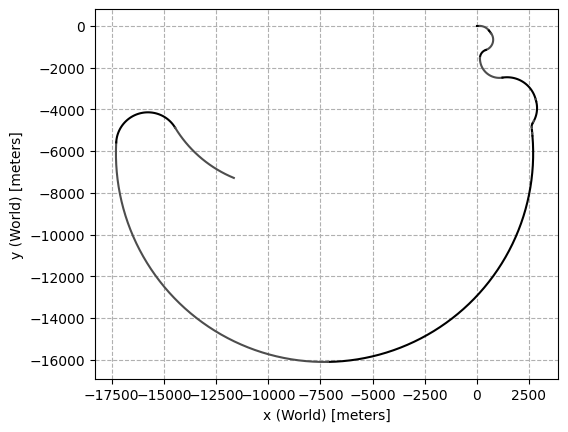

In [180]:
# Example 1: Standard Randomization
# road_randomization_params = {
#     'num_elements_range': (3, 6),          # Road will have 3 to 6 elements
#     'straight_length_range': (100.0, 150.0), # Length of straight segments between 100 and 150 meters
#     'curvature_range': (-1/300.0, 1/300.0), # Curvature between -1/300 and 1/300 for curves
#     'angle_range': (20.0, 45.0)            # Angle of the curves between 20 and 45 degrees
# }

# # Example 2: More Straight Roads
# road_randomization_params = {
#     'num_elements_range': (2, 4),            # Fewer elements, 2 to 4
#     'straight_length_range': (150.0, 300.0), # Longer straight segments between 150 and 300 meters
#     'curvature_range': (-1/1000.0, 1/1000.0), # Small curvature for gentler curves
#     'angle_range': (10.0, 30.0)              # Curves have lower angles between 10 and 30 degrees
# }

# # Example 3: More challenging roads with Tighter curves
road_randomization_params = {
    'num_elements_range': (15, 20),             # More road elements
    'straight_length_range': (80.0, 200.0),   # Shorter straight segments
    'curvature_range': (-1/300.0, 1/300.0),   # Tighter curves
    'angle_range': (30.0, 150.0)               # More aggressive curves with wider angle range
}

# # Example 4: Completely Randomized
# road_randomization_params = {
#     'num_elements_range': (1, 10),             # Highly variable number of road elements
#     'straight_length_range': (50.0, 300.0),    # Straight segments can be very short or long
#     'curvature_range': (-1/50.0, 1/50.0),      # Very tight curves possible
#     'angle_range': (10.0, 90.0)                # Wide range of angles for curves
# }

random_env = create_env(road_elements_list = road_elements_list, )
random_env = DomainRandomizationWrapper(random_env, road_randomization_params=road_randomization_params)

# Reset the random env - this will create a new random road
random_env.reset()

# Render the road
random_env.render_matplotlib_init_figure()
random_env.render_matplotlib_plot_road()
plt.show()

## Setting up Training/Evaluation Environments:

In [181]:
### ------------- MAKE CHANGES TO THE ROAD RANDOMIZATION PARAMS HERE ------- ###
# Difficulty levels for curriculum learning
road_randomization_params_levels = {
    1: {
        'num_elements_range': (4, 8),
        'straight_length_range': (150.0, 300.0),
        'curvature_range': (-1/1000.0, 1/1000.0),
        'angle_range': (5.0, 15.0),
    },
    2: {
        'num_elements_range': (5, 10),
        'straight_length_range': (100.0, 200.0),
        'curvature_range': (-1/800.0, 1/800.0),
        'angle_range': (10.0, 30.0),
    },
    3: {
        'num_elements_range': (10, 12),
        'straight_length_range': (80.0, 150.0),
        'curvature_range': (-1/500.0, 1/500.0),
        'angle_range': (20.0, 45.0),
    },
    4: {
        'num_elements_range': (12, 17),
        'straight_length_range': (60.0, 120.0),
        'curvature_range': (-1/300.0, 1/300.0),
        'angle_range': (30.0, 60.0),
    },
    5: {
        'num_elements_range': (16,18),
        'straight_length_range': (50.0, 100.0),
        'curvature_range': (-1/200.0, 1/200.0),
        'angle_range': (45.0, 90.0),
    },
    6: {
        'num_elements_range': (18, 20),             # More road elements
        'straight_length_range': (50.0, 100.0),   # Shorter straight segments
        'curvature_range': (-1/100.0, 1/100.0),   # Tighter curves
        'angle_range': (30.0, 70.0)               # More aggressive curves with wider angle range
    }}



In [182]:
for idx, level in enumerate(road_randomization_params_levels):
    print(f"Training on difficulty level {level}")
    road_randomization_params = road_randomization_params_levels[level]

    # Create the training environment for this level
    train_env = create_env(road_randomization_params=road_randomization_params)
    train_env = DomainRandomizationWrapper(train_env, road_randomization_params = road_randomization_params)
    train_env = RewardWrapper(train_env)

Training on difficulty level 1
Training on difficulty level 2
Training on difficulty level 3
Training on difficulty level 4
Training on difficulty level 5
Training on difficulty level 6


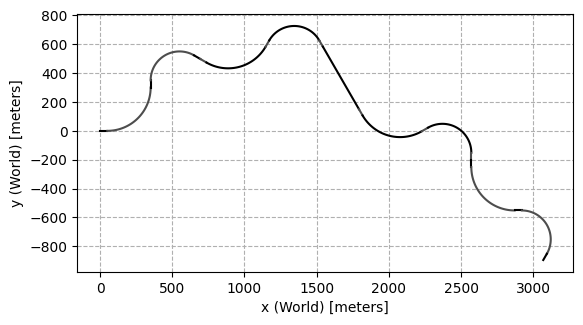

In [183]:
# Define a fixed, difficult road for evaluation
road_elements_list_difficult = [
    {"type": "straight", "length": 50.0},
    {"type": "curved", "curvature": 1/300.0, "angle_in_degrees": 90.0},
    {"type": "straight", "length": 50.0},
    {"type": "curved", "curvature": -1/200.0, "angle_in_degrees": 120.0},
    {"type": "straight", "length": 50.0},
    {"type": "straight", "length": 50.0},
    {"type": "curved", "curvature": 1/300.0, "angle_in_degrees": 90.0},
    {"type": "straight", "length": 50.0},
    {"type": "curved", "curvature": -1/200.0, "angle_in_degrees": 120.0},
    {"type": "straight", "length": 50.0},
    {"type": "straight", "length": 500.0},
    {"type": "straight", "length": 50.0},
    {"type": "curved", "curvature": 1/300.0, "angle_in_degrees": 90.0},
    {"type": "straight", "length": 50.0},
    {"type": "curved", "curvature": -1/200.0, "angle_in_degrees": 120.0},
    {"type": "straight", "length": 50.0},
    {"type": "straight", "length": 50.0},
    {"type": "curved", "curvature": 1/300.0, "angle_in_degrees": 90.0},
    {"type": "straight", "length": 50.0},
    {"type": "curved", "curvature": -1/200.0, "angle_in_degrees": 120.0},
    {"type": "straight", "length": 50.0},
]

# Create the evaluation environment with the fixed difficult road
eval_env = create_env(None, road_elements_list_difficult)

# Render the road
eval_env.render_matplotlib_init_figure()
eval_env.render_matplotlib_plot_road()
plt.show()

## Model Definition and Training:

Training on difficulty level 1
Epoch 1/18 at difficulty level 1


/Users/ybguzel/Desktop/Full-Scale-Autonomous-Driving/PPO_RL/myenv/lib/python3.10/site-packages/stable_baselines3/common/policies.py:486: UserWarning: As shared layers in the mlp_extractor are removed since SB3 v1.8.0, you should now pass directly a dictionary and not a list (net_arch=dict(pi=..., vf=...) instead of net_arch=[dict(pi=..., vf=...)])
  warnings.warn(


ERROR: Curved road element specified with angular span of 29810.2 [degrees], which is greater than the limits of this class. SKIPPING this element
ERROR: Curved road element specified with angular span of 449.2 [degrees], which is greater than the limits of this class. SKIPPING this element
Epoch 2/18 at difficulty level 1
ERROR: Curved road element specified with angular span of 4234.7 [degrees], which is greater than the limits of this class. SKIPPING this element
Epoch 3/18 at difficulty level 1
ERROR: Curved road element specified with angular span of 1970.0 [degrees], which is greater than the limits of this class. SKIPPING this element
ERROR: Curved road element specified with angular span of 694.4 [degrees], which is greater than the limits of this class. SKIPPING this element
ERROR: Curved road element specified with angular span of 584.7 [degrees], which is greater than the limits of this class. SKIPPING this element
Training on difficulty level 2
Epoch 4/18 at difficulty leve

/Users/ybguzel/Desktop/Full-Scale-Autonomous-Driving/PPO_RL/ai4r-gym/utils.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots()


Epoch 12/18 at difficulty level 4
ERROR: Curved road element specified with angular span of 381.6 [degrees], which is greater than the limits of this class. SKIPPING this element
ERROR: Curved road element specified with angular span of 2647.8 [degrees], which is greater than the limits of this class. SKIPPING this element
ERROR: Curved road element specified with angular span of 730.3 [degrees], which is greater than the limits of this class. SKIPPING this element
ERROR: Curved road element specified with angular span of 385.6 [degrees], which is greater than the limits of this class. SKIPPING this element
ERROR: Curved road element specified with angular span of 1297.7 [degrees], which is greater than the limits of this class. SKIPPING this element
ERROR: Curved road element specified with angular span of 641.7 [degrees], which is greater than the limits of this class. SKIPPING this element
Training on difficulty level 5
Epoch 13/18 at difficulty level 5
ERROR: Curved road element sp

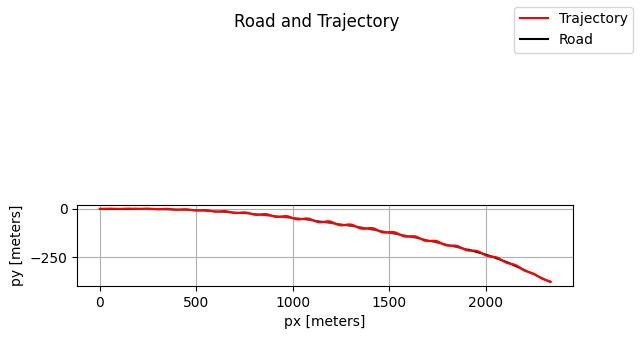

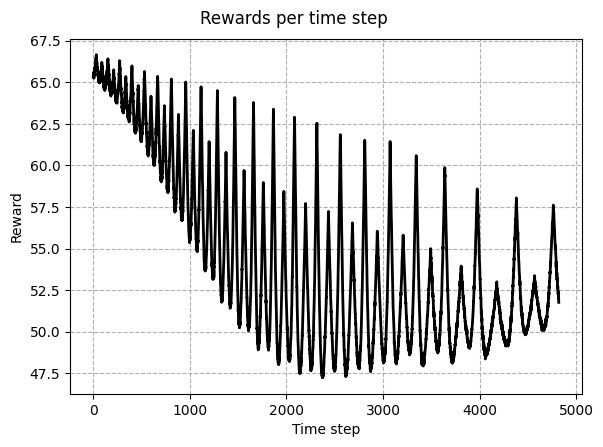

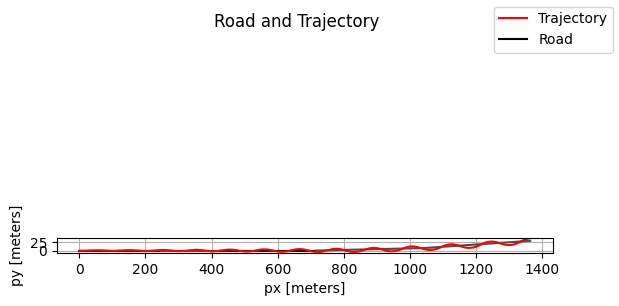

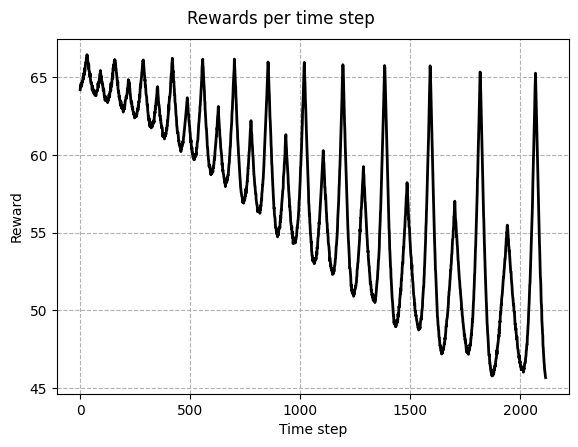

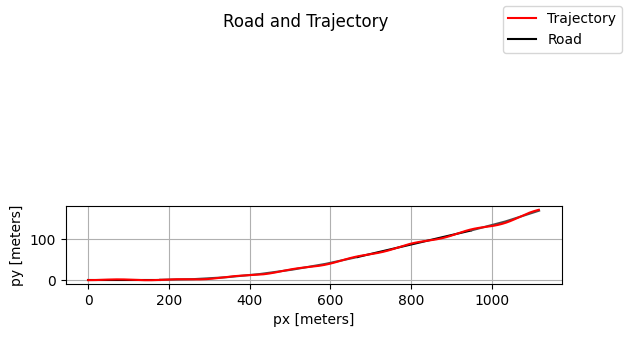

...

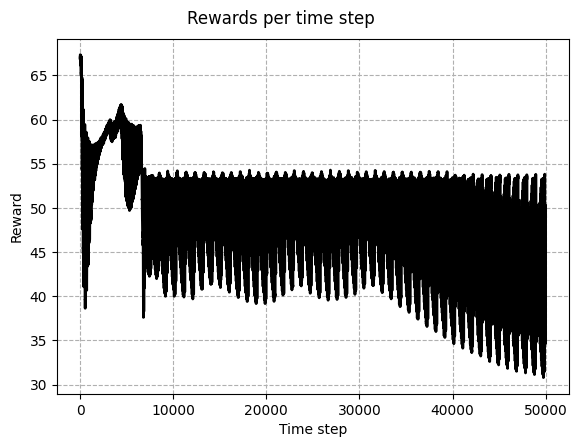

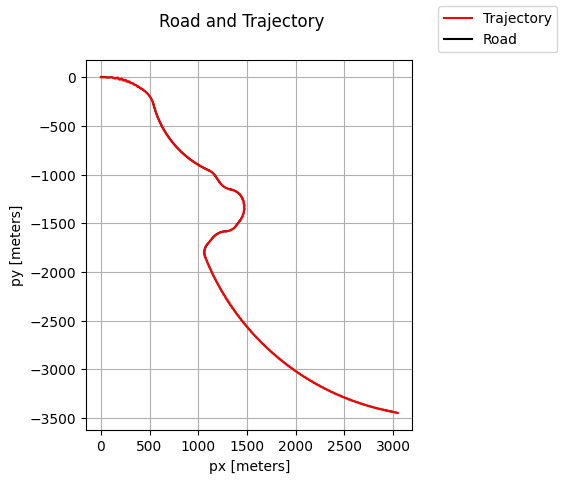

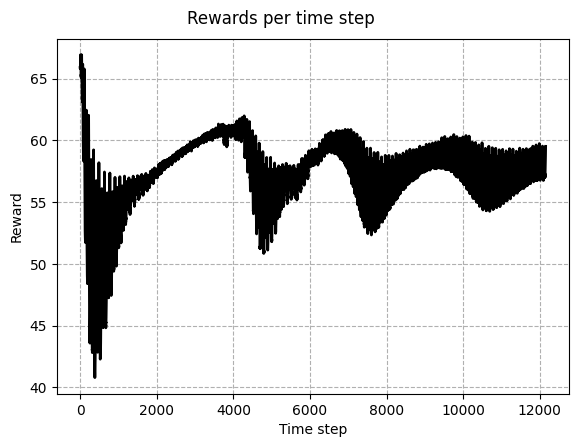

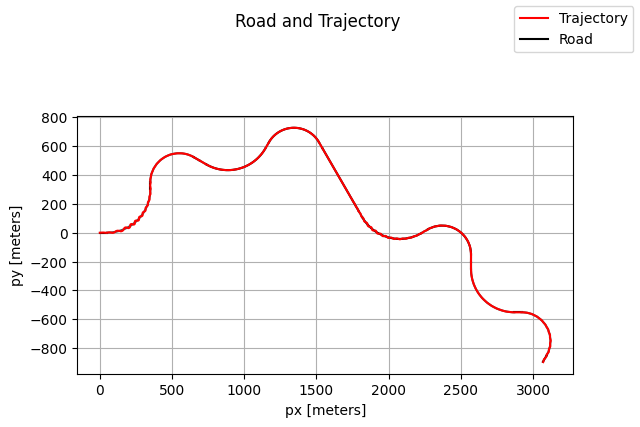

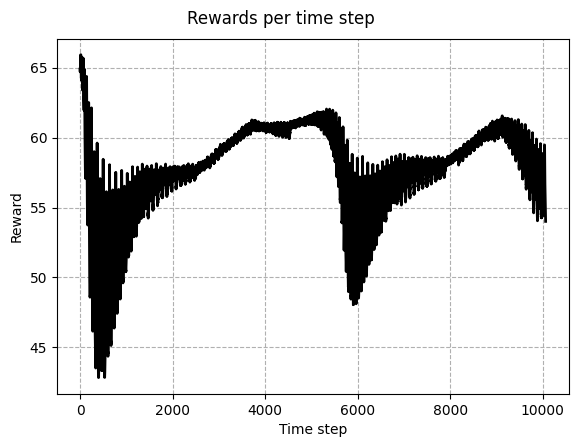

In [184]:
import math
from stable_baselines3.common.vec_env import VecNormalize

# Initialize variables
model_name = "PPO_dr_wet_long"
TIMESTEPS_PER_EPOCH = 20000
TOTAL_EPOCHS = 18

logdir = "logs"
models_dir = f"models/{model_name}"
figs_dir_train = f"models/{model_name}/figs_train"
figs_dir_test = f"models/{model_name}/figs_test"

ensure_dirs([logdir, models_dir, figs_dir_train, figs_dir_test])

# Calculate epochs per level
levels = sorted(road_randomization_params_levels.keys())
EPOCHS_PER_LEVEL = TOTAL_EPOCHS // len(levels)

current_epoch = 0

# Start training loop over difficulty levels
for idx, level in enumerate(levels):
    print(f"Training on difficulty level {level}")
    road_randomization_params = road_randomization_params_levels[level]

    # Create the training environment for this level
    train_env = create_env(road_randomization_params=road_randomization_params)
    train_env = DomainRandomizationWrapper(train_env, road_randomization_params = road_randomization_params)
    train_env = RewardWrapper(train_env)

    if idx == 0:
        # Initialize the model with the environment from the first level
        policy_kwargs = dict(net_arch=[dict(pi=[256, 256], vf=[256, 256])])

        model = PPO(
            "MultiInputPolicy",
            env=train_env,
            learning_rate=1e-4,
            n_steps=2048,
            batch_size=2048,
            n_epochs=10,
            gamma=0.95,
            gae_lambda=0.95,
            clip_range=0.2,
            ent_coef=0.00,
            vf_coef=0.5,
            max_grad_norm=0.3,
            tensorboard_log=logdir,
            policy_kwargs=policy_kwargs
        )
    else:
        # For subsequent levels, set the new environment
        model.set_env(train_env)

    for epoch in range(1, EPOCHS_PER_LEVEL + 1):
        current_epoch += 1
        print(f"Epoch {current_epoch}/{TOTAL_EPOCHS} at difficulty level {level}")

        model.learn(
            total_timesteps=TIMESTEPS_PER_EPOCH,
            reset_num_timesteps=False,
            tb_log_name=f"{model_name}"
        )
        model.save(f"{models_dir}/{TIMESTEPS_PER_EPOCH * (current_epoch)}")

        # Evaluate on the most recent training road
        eval_model(train_env, model, figs_dir_train, TIMESTEPS_PER_EPOCH * current_epoch, max_steps=50000)



    # Close the training environment before moving to the next level
    train_env.close()
    
# Evaluate on evaluation road
eval_model(eval_env, model, figs_dir_test, TIMESTEPS_PER_EPOCH * current_epoch, max_steps=50000)
# After training, save the final model
model.save(f"{models_dir}/final_model")


## Evaluating the RL Policy:

### Load an RL model from the training loop:

In [185]:
model_name = "PPO_dr_long"
model_idx = 950000

path_for_saving_figures = f"models/{model_name}/eval"
ensure_dir(path_for_saving_figures)

### Put the RL model into a policy class with a 'standardize' interface

In [186]:
from policies.rl_policy import RLPolicy

# Put the RL model into a policy class
rl_policy = RLPolicy(model)

### Perform One simulation of the policy, plot the time series results:



Now starting simulation.
Simulation finished


Saved figure: models/PPO_dr_long/eval/ad_cartesian_coords_example.pdf
Saved figure: models/PPO_dr_long/eval/ad_time_series_example.pdf


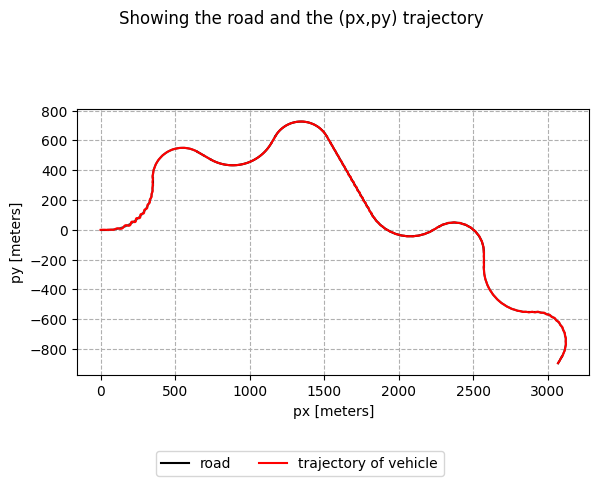

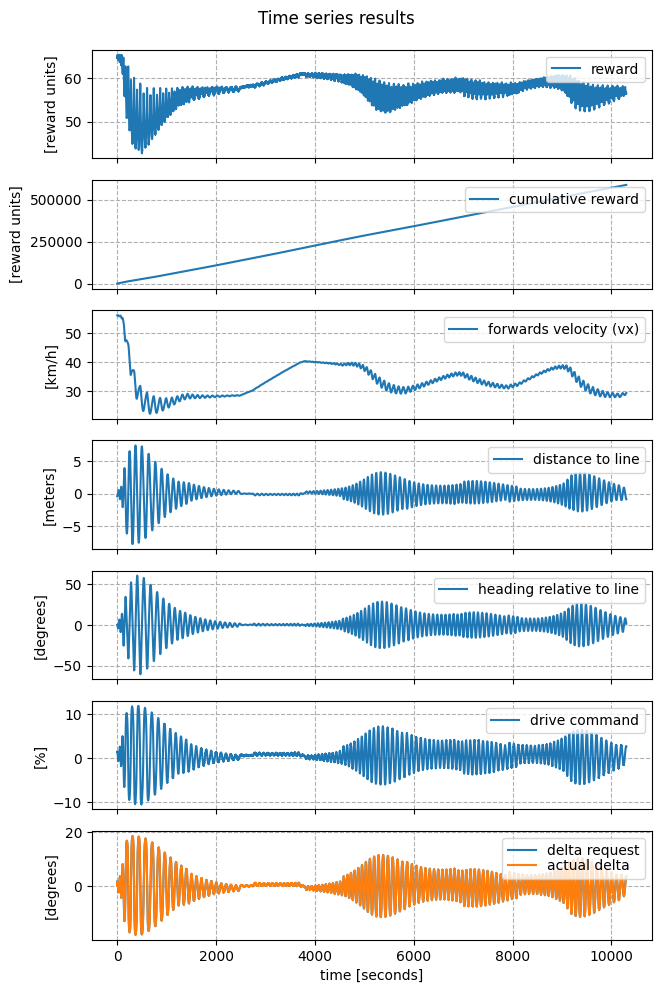

In [187]:
# Import the function for simulating the autonomous driving environment
from evaluation.evaluation_for_autonomous_driving import simulate_policy
from evaluation.evaluation_for_autonomous_driving import plot_results_from_time_series_dict

# Specify the length of the simulation in time steps
# > If termination or truncation is flagged by the "step" function,
#   Then, the simulation ends.
N_sim = 50000

# Specify the seed for when the simulate function resets the random number generator
sim_seed = 2

# Call the function for simulating a given RL model
sim_time_series_dict = simulate_policy(eval_env, N_sim, rl_policy, seed=sim_seed, verbose=1)

# Call the plotting function
file_name_suffix = "example"
plot_details_list = plot_results_from_time_series_dict(eval_env, sim_time_series_dict, path_for_saving_figures, file_name_suffix, should_plot_reward=True)

### Animate the time series results:

In [188]:
def animate_from_sim_time_series_dict(sim_time_series_dict, Ts, path_for_saving_figures):
    # Extract the necessary trajectory information from the "sim_time_series_dict"
    px_traj    = sim_time_series_dict["px"]
    py_traj    = sim_time_series_dict["py"]
    theta_traj = sim_time_series_dict["theta"]
    delta_traj = sim_time_series_dict["delta"]
    # Call the environments function to create the simulation
    ani = eval_env.unwrapped.render_matplotlib_animation_of_trajectory(px_traj, py_traj, theta_traj, delta_traj, Ts, traj_increment=3)
    # Save the animation
    ani.save(f"{path_for_saving_figures}/trajectory_animation.gif")
    print(f'Saved animation at {path_for_saving_figures}/trajectory_animation.gif')
    # Return the animation object
    return ani

MovieWriter ffmpeg unavailable; using Pillow instead.


Now creating the animation, this may take some time.
Saved animation at models/PPO_dr_long/eval/trajectory_animation.gif


Animation size has reached 20974306 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


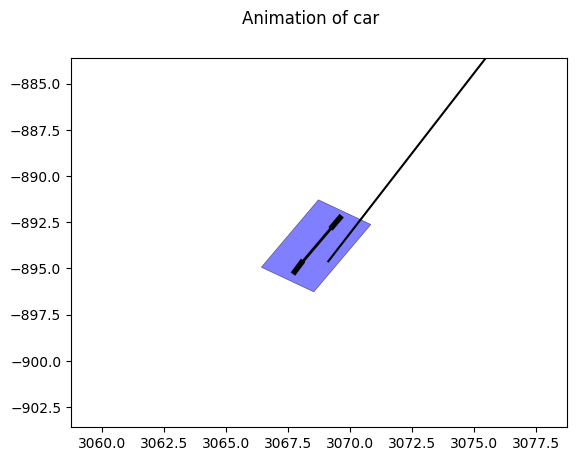

In [189]:
# Call the animation functoin
ani = animate_from_sim_time_series_dict(sim_time_series_dict, numerical_integration_parameters["Ts"], path_for_saving_figures)
# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())

## Performance Metrics:

### Define a performance Metrics Function per simulation time series:

In [190]:
import numpy as np
from typing import Dict, Any

def compute_performance_metrics_from_time_series(sim_time_series_dict: Dict[str, Any], 
                                                Ts_sim: float = 1, 
                                                speed_limit_kmh: float = 100.0, 
                                                distance_threshold_m: float = 4.0) -> Dict[str, float]:
    """
    Computes various performance metrics from simulation time series data, including temporal metrics.
    
    Parameters:
    - sim_time_series_dict (Dict[str, Any]): Dictionary containing time series data with keys:
        - "distance_to_closest_point": np.ndarray
        - "vx": np.ndarray (speed in m/s)
        - "road_progress_at_closest_point": np.ndarray
        - "omega": np.ndarray (angular velocity)
        - "delta": np.ndarray (steering angle)
    - Ts_sim (float): Time interval between samples (seconds). Default is 0.05.
    - speed_limit_kmh (float): Speed limit in km/h for evaluating speed-related metrics. Default is 30.0.
    - distance_threshold_m (float): Distance threshold in meters for evaluating lane deviation metrics. Default is 2.0.
    
    Returns:
    - Dict[str, float]: Dictionary containing computed performance metrics:
        - "avg_dist_to_line": Average absolute distance to the centre line (meters)
        - "max_dist_to_line": Maximum absolute distance to the centre line (meters)
        - "avg_speed_kmh": Average speed (km/h)
        - "std_speed_kmh": Standard deviation of speed (km/h)
        - "min_speed_kmh": Minimum speed (km/h)
        - "max_speed_kmh": Maximum speed (km/h)
        - "road_progress": Final road progress (meters)
        - "avg_omega": Average absolute angular velocity (rad/s)
        - "avg_delta": Average absolute steering angle (degrees)
        - "time_above_speed_limit": Total time spent above the speed limit (seconds)
        - "num_speed_limit_violations": Number of speed limit exceedances
        - "avg_duration_speed_violation": Average duration of speed limit violations (seconds)
        - "time_above_distance_threshold": Total time spent beyond distance threshold from lane centre (seconds)
        - "num_distance_threshold_violations": Number of distance threshold exceedances
        - "avg_duration_distance_violation": Average duration of distance threshold violations (seconds)
    """
    metrics = {}

    # Ensure all required keys are present
    required_keys = [
        "distance_to_closest_point",
        "vx",
        "road_progress_at_closest_point",
        "omega",
        "delta"
    ]
    for key in required_keys:
        if key not in sim_time_series_dict:
            raise KeyError(f"Missing key in sim_time_series_dict: '{key}'")

    # Distance to the center of the lane
    distance = sim_time_series_dict["distance_to_closest_point"]
    abs_distance = np.abs(distance)
    metrics["avg_dist_to_line"] = np.nanmean(abs_distance)
    metrics["max_dist_to_line"] = np.nanmax(abs_distance)

    # Speed (vx sensor) - Convert from m/s to km/h
    speed_m_s = sim_time_series_dict["vx"]
    speed_kmh = speed_m_s * 3.6
    abs_speed_kmh = np.abs(speed_kmh)
    metrics["avg_speed_kmh"] = np.nanmean(abs_speed_kmh)
    metrics["std_speed_kmh"] = np.nanstd(abs_speed_kmh)
    metrics["min_speed_kmh"] = np.nanmin(abs_speed_kmh)
    metrics["max_speed_kmh"] = np.nanmax(abs_speed_kmh)

    # Road progress
    road_progress = sim_time_series_dict["road_progress_at_closest_point"]
    metrics["road_progress"] = np.nanmax(road_progress)

    # Angular velocity (omega) and steering angle (delta)
    omega = sim_time_series_dict["omega"]
    delta = sim_time_series_dict["delta"]
    metrics["avg_omega"] = np.nanmean(np.abs(omega))
    metrics["avg_delta"] = np.nanmean(np.abs(delta))

    # Temporal Metrics for Speed
    above_speed_limit = speed_kmh > speed_limit_kmh
    metrics["time_above_speed_limit"] = np.sum(above_speed_limit) * Ts_sim
    metrics["num_speed_limit_violations"] = np.sum(np.diff(np.concatenate(([False], above_speed_limit, [False]))) == 1)
    
    # Calculate durations of speed limit violations
    speed_violation_durations = []
    in_violation = False
    duration = 0.0
    for flag in above_speed_limit:
        if flag:
            duration += Ts_sim
            in_violation = True
        elif in_violation:
            speed_violation_durations.append(duration)
            duration = 0.0
            in_violation = False
    if in_violation:
        speed_violation_durations.append(duration)
    if speed_violation_durations:
        metrics["avg_duration_speed_violation"] = np.mean(speed_violation_durations)
    else:
        metrics["avg_duration_speed_violation"] = 0.0

    # Temporal Metrics for Distance to Line
    above_distance_threshold = abs_distance > distance_threshold_m
    metrics["time_above_distance_threshold"] = np.sum(above_distance_threshold) * Ts_sim
    metrics["num_distance_threshold_violations"] = np.sum(np.diff(np.concatenate(([False], above_distance_threshold, [False]))) == 1)
    
    # Calculate durations of distance threshold violations
    distance_violation_durations = []
    in_violation = False
    duration = 0.0
    for flag in above_distance_threshold:
        if flag:
            duration += Ts_sim
            in_violation = True
        elif in_violation:
            distance_violation_durations.append(duration)
            duration = 0.0
            in_violation = False
    if in_violation:
        distance_violation_durations.append(duration)
    if distance_violation_durations:
        metrics["avg_duration_distance_violation"] = np.mean(distance_violation_durations)
    else:
        metrics["avg_duration_distance_violation"] = 0.0

    return metrics


### Wet Road

In [191]:
# Simulate with the same seed as above to check that it gets the results consistent
sim_seed = 2
sim_time_series_dict = simulate_policy(eval_env, N_sim, rl_policy, seed=sim_seed, verbose=1)

# Call the function for computing the performance metrics
pm_dict = compute_performance_metrics_from_time_series(sim_time_series_dict)

# Display the performance metric values
print("Performance Metric dictionary:")
print(pm_dict)







Now starting simulation.
Simulation finished


Performance Metric dictionary:
{'avg_dist_to_line': np.float32(1.0820824), 'max_dist_to_line': np.float32(7.726288), 'avg_speed_kmh': np.float32(33.466732), 'std_speed_kmh': np.float32(5.136238), 'min_speed_kmh': np.float32(22.327778), 'max_speed_kmh': np.float32(55.99155), 'road_progress': np.float32(4660.4717), 'avg_omega': np.float32(0.21388803), 'avg_delta': np.float32(0.07043435), 'time_above_speed_limit': np.int64(0), 'num_speed_limit_violations': np.int64(0), 'avg_duration_speed_violation': 0.0, 'time_above_distance_threshold': np.int64(387), 'num_distance_threshold_violations': np.int64(22), 'avg_duration_distance_violation': np.float64(35.18181818181818)}


### Dry Road

In [192]:
# Simulate with the same seed as above to check that it gets the results consistent
sim_seed = 2
# Set the road condition
eval_env.unwrapped.set_road_condition(road_condition="dry")
sim_time_series_dict = simulate_policy(eval_env, N_sim, rl_policy, seed=sim_seed, verbose=1)

# Call the function for computing the performance metrics
pm_dict = compute_performance_metrics_from_time_series(sim_time_series_dict)

# Display the performance metric values
print("Performance Metric dictionary:")
print(pm_dict)





Now starting simulation.
Simulation finished


Performance Metric dictionary:
{'avg_dist_to_line': np.float32(1.093384), 'max_dist_to_line': np.float32(8.556641), 'avg_speed_kmh': np.float32(31.43697), 'std_speed_kmh': np.float32(5.1443205), 'min_speed_kmh': np.float32(19.980803), 'max_speed_kmh': np.float32(55.988953), 'road_progress': np.float32(4660.4717), 'avg_omega': np.float32(0.20380987), 'avg_delta': np.float32(0.07015585), 'time_above_speed_limit': np.int64(0), 'num_speed_limit_violations': np.int64(0), 'avg_duration_speed_violation': 0.0, 'time_above_distance_threshold': np.int64(422), 'num_distance_threshold_violations': np.int64(22), 'avg_duration_distance_violation': np.float64(38.36363636363637)}
